In [ ]:
!pip install welly

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.2/79.2 kB 1.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.4/47.4 kB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 90.6/90.6 kB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.4/76.4 kB 5.0 MB/s eta 0:00:00


In [ ]:
!pip install pardata

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.1/45.1 kB 1.2 MB/s eta 0:00:00


In [ ]:
import pardata
import os
import requests
import tarfile
import pandas as pd
import numpy as np
import welly.quality as wq
from IPython.display import HTML, display
import welly
import matplotlib.pyplot as plt

In [ ]:
# Download the dataset
fname = 'taranaki-basin-curated-well-logs.tar.gz'
url = 'https://dax-cdn.cdn.appdomain.cloud/dax-taranaki-basin-curated-well-logs/1.0.0/'
download_link = url + fname
r = requests.get(download_link, allow_redirects=True)
open(fname , 'wb').write(r.content)

228743380

In [ ]:
tar = tarfile.open(fname)
tar.extractall()
tar.close()

In [ ]:
data_path = "taranaki-basin-curated-well-logs"
os.path.exists(data_path)

True

In [ ]:
logs_df = pd.read_csv(data_path + '/logs.csv')

<ipython-input-6-807d5dddc5c5>:2: DtypeWarning: Columns (21) have mixed types. Specify dtype option on import or set low_memory=False.
  logs_df = pd.read_csv(data_path + '/logs.csv')


In [ ]:
logs_df.head()

,BS,CALI,DENS,DRHO,DTC,GR,NEUT,PEF,RESD,RESM,...,TEMP,TENS,X,Y,Z,DEPT,ONSHORE,DIRSURVEY,WELLNAME,FORMATION
0,12.25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,424403.93838,399869.5574,229.4244,27.5844,True,False,Ahuroa South B-1,NaN
1,12.25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,424403.93838,399869.5574,229.5768,27.7368,True,False,Ahuroa South B-1,NaN
2,12.25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,424403.93838,399869.5574,229.7292,27.8892,True,False,Ahuroa South B-1,NaN
3,12.25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,33.0429,NaN,424403.93838,399869.5574,229.8816,28.0416,True,False,Ahuroa South B-1,NaN
4,12.25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,33.0429,NaN,424403.93838,399869.5574,230.0340,28.1940,True,False,Ahuroa South B-1,NaN


In [ ]:
df = logs_df[['DENS', 'DRHO', 'GR', 'PEF', 'DEPT', 'WELLNAME']]

In [ ]:
df.set_index(['WELLNAME', 'DEPT'], inplace=True)

In [ ]:
df.head()

DENS  DRHO  GR  PEF
WELLNAME         DEPT                        
Ahuroa South B-1 27.5844   NaN   NaN NaN  NaN
                 27.7368   NaN   NaN NaN  NaN
                 27.8892   NaN   NaN NaN  NaN
                 28.0416   NaN   NaN NaN  NaN
                 28.1940   NaN   NaN NaN  NaN

In [ ]:
for well in df.index.get_level_values(0).unique():
    for colum in df.columns:
      if df.loc[well][colum].notnull().any() != True:
        df = df.drop(index = well, level = 'WELLNAME')
        break

In [ ]:
wells = ['Ahuroa South B-1', 'Ahuroa-1', 'Ahuroa-1A', 'Ahuroa-2', 'Ahuroa-2A','Ahuroa-4', 'Beluga-1', 'Cape Farewell-1', 'Cardiff-1', 'Cardiff-2', 'Cheal-1', 'Cheal-2', 'Cheal-A6', 'Cheal-A6 ST1',
         'Fresne-1', 'Goldie-2 ST1', 'Goss-A1', 'Goss-A1 ST1', 'Hector-1', 'Hochstetter-1', 'Hoki-1', 'Hu Road-1', 'Kahili-1', 'Kahu-1', 'Kaimiro-2', 'Kaimiro-3', 'Kaimiro-5', 'Kapuni-14',
         'Kapuni-15', 'Kapuni-15A', 'Kapuni-17', 'Kapuni-18', 'Kiwi-1', 'Kongahu-1', 'Konini-1', 'Kora-1', 'Kora-2', 'Kora-3', 'Kora-4', 'Kowhai-A1R', 'Kupe South-2', 'Kupe South-3B',
         'Kupe South-5', 'Kupe South-6', 'Kupe South-7', 'Kupe South-7ST1', 'MA-02A', 'MB-N(5)', 'MB-P(8)', 'MB-Q(10)', 'MB-R(1)', 'MB-V(3)', 'MB-Z(11)', 'MN1P4', 'Maari-1A', 'Mangahewa-2',
         'Mangahewa-3', 'Mangahewa-04', 'Manu-1', 'Maui South-1', 'Maui-6', 'Maui-7', 'McKee-2C', 'McKee-6A', 'McKee-7A', 'McKee-8', 'Moana-1', 'Moki-1', 'Motueka-1', 'Ngaere-1', 'Ngaere-2',
         'Oakura-1', 'Ohanga-1', 'Oru-1', 'POB-04A', 'Paritutu-1', 'Piakau North-A1', 'Piakau North-A2', 'Piakau-1', 'Pohokura South-1', 'Pohokura-3', 'Radnor-1', 'Romney-1', 'Sidewinder-1',
         'Surrey-2ST1', 'Takapou-1', 'Taranga-1', 'Taranui-1', 'Tariki North-1A', 'Tariki-1', 'Tariki-1A', 'Tariki-2', 'Tawa B-1', 'Tawa B-1 ST2', 'Te Kiri-1', 'Te Kiri-2', 'Te Whatu-2',
         'Tipoka-2', 'Toetoe-2', 'Toetoe-4A', 'Toetoe-5A', 'Toetoe-6B', 'Toetoe-7A', 'Toka-1', 'Toko-2', 'Toru-1', 'Totara-1', 'Trapper-A1', 'Tuatara-1', 'Tuhua-2B', 'Tuhua-3D', 'Tuhua-4',
         'Tuhua-5A', 'Tuihu-1', 'Turangi-1', 'Turangi-2', 'Waihapa-1B', 'Waihapa-2', 'Waihapa-4', 'Waihapa-5', 'Waihapa-6', 'Waihapa-6A', 'Waihi-1', 'Waihi-1A', 'Waimanu-1', 'Witiora-1']

In [ ]:
df = df.drop(index = wells, level = 'WELLNAME')

In [ ]:
df.index.get_level_values(0).nunique()

116

In [ ]:
pd.set_option('display.max_rows', 50)

In [ ]:
def values_nan(df, dept_1, dept_2, well):
    depth_mask = (df.index.get_level_values(1) < dept_1) | (df.index.get_level_values(1) > dept_2)
    mask = (df.index.get_level_values(0) == well) & depth_mask
    df = df[~mask | (df.index.get_level_values(0) != well)]
    return df

In [ ]:
nan_list = [{'dept_1': 2403.5004, 'dept_2': 3076.4988, 'well': 'Ahuroa South B-1ST1'},
            {'dept_1': 972.6168, 'dept_2': 2515.3620, 'well': 'Ahuroa-5'},
            {'dept_1': 973.0740, 'dept_2': 2379.2688, 'well': 'Ahuroa-5 ST1'},
            {'dept_1': 1173.6324, 'dept_2': 2128.4184, 'well': 'Albacore-1'},
            {'dept_1': 1501.1400, 'dept_2': 3082.4424, 'well': 'Amokura-1'},
            {'dept_1': 604.5708, 'dept_2': 2367.3816, 'well': 'Arakamu-1'},
            {'dept_1': 1501.5972, 'dept_2': 3041.4468, 'well': 'Arawa-1'},
            {'dept_1': 1570.0248, 'dept_2': 3254.3496, 'well': 'Awatea-1'},
            {'dept_1': 394.5636, 'dept_2': 1421.4348, 'well': 'Bluff-1'},
            {'dept_1': 1689.0492, 'dept_2': 2414.9304, 'well': 'Cape Egmont-1'},
            {'dept_1': 2912.0592, 'dept_2': 4931.9688, 'well': 'Cardiff-2AST1'},
            {'dept_1': 387.5532, 'dept_2': 1847.8500, 'well': 'Cheal B-2'},
            {'dept_1': 725.5764, 'dept_2': 1901.9520, 'well': 'Cheal B-3'},
            {'dept_1': 404.6220, 'dept_2': 1877.4156, 'well': 'Cheal-A3X'},
            {'dept_1': 401.5740, 'dept_2': 1839.9252, 'well': 'Cheal-A4'},
            {'dept_1': 1248.6132, 'dept_2': 1824.3804, 'well': 'Cheal-A7'},
            {'dept_1': 268.2240, 'dept_2': 1532.3820, 'well': 'Cheal-B-H1-MM'},
            {'dept_1': 786.5364, 'dept_2': 2266.4928, 'well': 'Cheal-B4'},
            {'dept_1': 460.5528, 'dept_2': 1785.9756, 'well': 'Clematis-1'},
            {'dept_1': 570.5856, 'dept_2': 2433.3708, 'well': 'Crusader-1'},
            {'dept_1': 439.5216, 'dept_2': 2003.9076, 'well': 'Goldie-1'},
            {'dept_1': 627.5832, 'dept_2': 1995.3732, 'well': 'Goldie-2 ST2'},
            {'dept_1': 3701.6436, 'dept_2': 4564.3800, 'well': 'Goss-A1 ST2'},
            {'dept_1': 406.6032, 'dept_2': 1419.9108, 'well': 'Heaphy-1'},
            {'dept_1': 451.5612, 'dept_2': 1915.9728, 'well': 'Hihi-1'},
            {'dept_1': 451.5612, 'dept_2': 1777.4412, 'well': 'Hihi-1A'},
            {'dept_1': 632.6124, 'dept_2': 1664.3604, 'well': 'Honeysuckle-1'},
            {'dept_1': 431.1396, 'dept_2': 1803.3492, 'well': 'Hursthouse-1'},
            {'dept_1': 1609.0392, 'dept_2': 3421.3800, 'well': 'Kahawai-1'},
            {'dept_1': 862.5840, 'dept_2': 2432.4564, 'well': 'Kahili-1A'},
            {'dept_1': 2486.5584, 'dept_2': 3012.4908, 'well': 'Kahili-1B'},
            {'dept_1': 1873.1484, 'dept_2': 2450.4396, 'well': 'Kahili-1C'},
            {'dept_1': 597.5604, 'dept_2': 2007.4128, 'well': 'Kaimiro-5ST1'},
            {'dept_1': 481.5840, 'dept_2': 1992.4776, 'well': 'Kaimiro-7ST1'},
            {'dept_1': 606.0948, 'dept_2': 1791.4620, 'well': 'Kakariki-1'},
            {'dept_1': 1643.0244, 'dept_2': 2814.3708, 'well': 'Kanuka-1'},
            {'dept_1': 1343.1012, 'dept_2': 4051.8588, 'well': 'Kapuni-16'},
            {'dept_1': 494.5380, 'dept_2': 2014.4232, 'well': 'Karaka-A1'},
            {'dept_1': 753.6180, 'dept_2': 2186.4828, 'well': 'Karewa-1'},
            {'dept_1': 1606.6008, 'dept_2': 3125.4192, 'well': 'Kea-1'},
            {'dept_1': 2266.6452, 'dept_2': 3838.9560, 'well': 'Kopuwai-1'},
            {'dept_1': 900.0744, 'dept_2': 2705.8620, 'well': 'Korito-1'},
            {'dept_1': 610.5144, 'dept_2': 3362.8584, 'well': 'Kowhai-A1'},
            {'dept_1': 1895.5512, 'dept_2': 3497.8848, 'well': 'Kupe South-1'},
            {'dept_1': 2834.6400, 'dept_2': 3778.9104, 'well': 'Kupe South-4'},
            {'dept_1': 2940.5580, 'dept_2': 3613.8612, 'well': 'MA-05A'},
            {'dept_1': 2361.1332, 'dept_2': 3610.3560, 'well': 'MA-14A'},
            {'dept_1': 2851.5564, 'dept_2': 3624.9864, 'well': 'MB-03A'},
            {'dept_1': 2518.1052, 'dept_2': 3405.3780, 'well': 'MB-05B'},
            {'dept_1': 2233.5744, 'dept_2': 4374.4896, 'well': 'MB-S(12)'},
            {'dept_1': 3040.5324, 'dept_2': 3617.3664, 'well': 'MB-T(9)'},
            {'dept_1': 3437.5344, 'dept_2': 4048.9632, 'well': 'MB-W(2)'},
            {'dept_1': 3073.1460, 'dept_2': 3457.9560, 'well': 'MB-X(4)'},
            {'dept_1': 703.6308, 'dept_2': 2169.8712, 'well': 'Maari-1'},
            {'dept_1': 692.5056, 'dept_2': 1476.4512, 'well': 'Maari-2'},
            {'dept_1': 464.5152, 'dept_2': 1121.3592, 'well': 'Maketawa-1'},
            {'dept_1': 4005.5292, 'dept_2': 5099.4564, 'well': 'Mangahewa-06'},
            {'dept_1': 485.0892, 'dept_2': 2157.3744, 'well': 'Maui-5'},
            {'dept_1': 1731.5688, 'dept_2': 2312.9748, 'well': 'McKee-10'},
            {'dept_1': 32.6136, 'dept_2': 577.4436, 'well': 'McKee-6'},
            {'dept_1': 614.0196, 'dept_2': 1849.3740, 'well': 'Miromiro-1'},
            {'dept_1': 2656.6368, 'dept_2': 3784.3968, 'well': 'Mokau-1'},
            {'dept_1': 526.0848, 'dept_2': 2560.4724, 'well': 'Moturoa-5'},
            {'dept_1': 179.5272, 'dept_2': 1042.8732, 'well': 'Moturoa-6'},
            {'dept_1': 179.5272, 'dept_2': 1835.3532, 'well': 'Moturoa-6 ST1'},
            {'dept_1': 366.5220, 'dept_2': 1177.4424, 'well': 'Moturoa-7'},
            {'dept_1': 998.5248, 'dept_2': 1994.4588, 'well': 'Ngatoro-2'},
            {'dept_1': 552.6024, 'dept_2': 2401.3668, 'well': 'Ngatoro-3'},
            {'dept_1': 645.5664, 'dept_2': 1890.9792, 'well': 'Ngatoro-3ST1'},
            {'dept_1': 1338.0720, 'dept_2': 1990.9536, 'well': 'Ngatoro-9'},
            {'dept_1': 425.5008, 'dept_2': 2015.9472, 'well': 'Ngatoro-11'},
            {'dept_1': 417.5760, 'dept_2': 1997.3544, 'well': 'Ngatoro-13'},
            {'dept_1': 1418.5392, 'dept_2': 3737.4576, 'well': 'Ohanga-2'},
            {'dept_1': 1808.0736, 'dept_2': 4247.9976, 'well': 'Okoki-1'},
            {'dept_1': 1891.5888, 'dept_2': 3827.9832, 'well': 'Pateke-2'},
            {'dept_1': 3414.5220, 'dept_2': 4875.8856, 'well': 'Pateke-3HST1'},
            {'dept_1': 1991.5632, 'dept_2': 4502.9628, 'well': 'Pohokura South-1B'},
            {'dept_1': 3187.1412, 'dept_2': 4175.9124, 'well': 'Pukeko-1'},
            {'dept_1': 3187.1412, 'dept_2': 3060.0396, 'well': 'Radnor-1A'},
            {'dept_1': 4048.5060, 'dept_2': 5020.9704, 'well': 'Radnor-1B'},
            {'dept_1': 1042.5684, 'dept_2': 2270.4552, 'well': 'Rahi-1'},
            {'dept_1': 900.0744, 'dept_2': 3058.3632, 'well': 'Rahotu-1'},
            {'dept_1': 574.5480, 'dept_2': 2094.8904, 'well': 'Ratanui-1'},
            {'dept_1': 452.6280, 'dept_2': 1428.9024, 'well': 'Ratapiko-1'},
            {'dept_1': 426.1104, 'dept_2': 2122.9320, 'well': 'Richmond-1'},
            {'dept_1': 595.5792, 'dept_2': 1713.4332, 'well': 'Salisbury-1 ST1'},
            {'dept_1': 404.0124, 'dept_2': 1803.5016, 'well': 'Standish-1'},
            {'dept_1': 541.6296, 'dept_2': 2698.3944, 'well': 'Stent-1'},
            {'dept_1': 2745.6384, 'dept_2': 4477.3596, 'well': 'Stratford-1A'},
            {'dept_1': 569.0616, 'dept_2': 1935.9372, 'well': 'Supplejack South-1'},
            {'dept_1': 584.6064, 'dept_2': 2077.9740, 'well': 'Supplejack South-1A'},
            {'dept_1': 568.1472, 'dept_2': 2547.3660, 'well': 'Supplejack-1'},
            {'dept_1': 605.6376, 'dept_2': 1881.9876, 'well': 'Surrey-1'},
            {'dept_1': 578.5104, 'dept_2': 1818.8940, 'well': 'Surrey-2'},
            {'dept_1': 412.5468, 'dept_2': 1580.9976, 'well': 'Tabla-1'},
            {'dept_1': 601.5228, 'dept_2': 1572.4632, 'well': 'Takahe-1'},
            {'dept_1': 700.5828, 'dept_2': 2261.9208, 'well': 'Tariki-D1'},
            {'dept_1': 1403.1468, 'dept_2': 3349.9044, 'well': 'Te Kumi-1'},
            {'dept_1': 755.5992, 'dept_2': 2888.8944, 'well': 'Te Popo-1'},
            {'dept_1': 2530.1448, 'dept_2': 4832.9088, 'well': 'Terrace-1'},
            {'dept_1': 2851.8612, 'dept_2': 3577.4376, 'well': 'Tieke-1'},
            {'dept_1': 2541.1176, 'dept_2': 3209.3916, 'well': 'Tipoka-1A'},
            {'dept_1': 1951.6344, 'dept_2': 2445.8676, 'well': 'Toetoe-4B'},
            {'dept_1': 604.5708, 'dept_2': 2670.3528, 'well': 'Tuhua-7'},
            {'dept_1': 1662.5316, 'dept_2': 2443.8864, 'well': 'Tuhua-8A'},
            {'dept_1': 1566.0624, 'dept_2': 3726.4848, 'well': 'Tui SW-2'},
            {'dept_1': 1506.6264, 'dept_2': 3076.9560, 'well': 'Tui-1'},
            {'dept_1': 3355.5432, 'dept_2': 5182.9716, 'well': 'Turangi-3'},
            {'dept_1': 4471.5684, 'dept_2': 4922.9772, 'well': 'Waihapa-1A'},
            {'dept_1': 801.6240, 'dept_2': 2783.4336, 'well': 'Waihapa-H1'},
            {'dept_1': 684.5808, 'dept_2': 2895.4476, 'well': 'Warea-1'},
            {'dept_1': 2053.1328, 'dept_2': 3649.9800, 'well': 'West Cape-1'},
            {'dept_1': 458.1144, 'dept_2': 1624.8888, 'well': 'Windsor-1'},
            {'dept_1': 450.6468, 'dept_2': 1457.8584, 'well': 'Windsor-2'},
            {'dept_1': 450.6468, 'dept_2': 1523.3904, 'well': 'Windsor-3A'},
            {'dept_1': 306.6288, 'dept_2': 1606.4484, 'well': 'Wingrove-2'}
]

In [ ]:
for params in nan_list:
    df = values_nan(df, **params)

In [ ]:
def interpolate_nan_values(group):
    for column in group.columns:
        series = group[column]

        # Find sequences of NaN values
        nan_sequences = []
        current_sequence = []
        for i in range(len(series)):
            if pd.isnull(series.iloc[i]):
                current_sequence.append(i)
            elif current_sequence:
                nan_sequences.append(current_sequence)
                current_sequence = []
        if current_sequence:
            nan_sequences.append(current_sequence)

        # Interpolate sequences of NaN values if they do not exceed 15
        for sequence in nan_sequences:
            if len(sequence) <= 100:
                # Interpolate the sequence with the upper and lower numerical values
                upper_value = series.iloc[sequence[0]-1] if sequence[0] > 0 else series.iloc[sequence[0]]
                lower_value = series.iloc[sequence[-1]+1] if sequence[-1] < len(series) - 1 else series.iloc[sequence[-1]]
                series.iloc[sequence] = np.interp(sequence, [sequence[0], sequence[-1]], [upper_value, lower_value])

        group[column] = series

    return group

df_depth_filtered = df.groupby(level=0).apply(interpolate_nan_values).droplevel(0)

In [ ]:
tests = {'GR': [wq.no_flat,
                  wq.no_gaps,
                  wq.all_positive],
         'DENS': [wq.no_flat,
                  wq.no_gaps,
                  wq.all_positive],
         'DRHO': [wq.no_flat,
                  wq.no_gaps],
         'PEF': [wq.no_flat,
                  wq.no_gaps,
                  wq.all_positive],}

In [ ]:
for well in df_depth_filtered.index.get_level_values(0).unique():
  w = df_depth_filtered.loc[well]
  wl = welly.Well({})
  for log in tests.keys():  # Проходим по логам, для которых есть тесты
        if log in w.columns:  # Проверяем, имеются ли данные по этому логe
            wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)

 # show test results in HTML table
  print('\n', '\n')
  print('WELL NAME: ' + well)
  print('CURVE QUALITY SUMMARY')
  html = wl.qc_table_html(tests)
  display(HTML(html, metadata = {'title': well,}))


 

WELL NAME: Ahuroa South B-1ST1
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Ahuroa-5
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Ahuroa-5 ST1
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Albacore-1
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Amokura-1
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Arakamu-1
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Arawa-1
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Awatea-1
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Bluff-1
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Cape Egmont-1
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Cardiff-2AST1
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Cheal B-2
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Cheal B-3
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Cheal-A3X
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Cheal-A4
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Cheal-A7
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Cheal-B-H1-MM
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Cheal-B4
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Clematis-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Crusader-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Goldie-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Goldie-2 ST2
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Goss-A1 ST2
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,2 / 3,0.667,True,False,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Heaphy-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Hihi-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Hihi-1A
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Honeysuckle-1
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Hursthouse-1
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Kahawai-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Kahili-1A
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Kahili-1B
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Kahili-1C
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Kaimiro-5ST1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Kaimiro-7ST1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Kakariki-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Kanuka-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Kapuni-16
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Karaka-A1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Karewa-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Kea-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Kopuwai-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Korito-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Kowhai-A1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Kupe South-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Kupe South-4
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: MA-05A
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: MA-14A
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: MB-03A
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: MB-05B
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: MB-S(12)
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: MB-T(9)
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: MB-W(2)
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: MB-X(4)
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Maari-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Maari-2
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Maketawa-1
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Mangahewa-06
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Maui-5
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: McKee-10
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: McKee-6
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Miromiro-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Mokau-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Moturoa-5
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Moturoa-6
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Moturoa-6 ST1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Moturoa-7
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Ngatoro-11
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Ngatoro-13
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Ngatoro-2
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Ngatoro-3
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Ngatoro-3ST1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Ngatoro-9
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Ohanga-2
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Okoki-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Pateke-2
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Pateke-3HST1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Pohokura South-1B
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Pukeko-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Radnor-1B
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Rahi-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Rahotu-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Ratanui-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Ratapiko-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Richmond-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Salisbury-1 ST1
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Standish-1
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Stent-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Stratford-1A
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Supplejack South-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Supplejack South-1A
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Supplejack-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Surrey-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Surrey-2
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Tabla-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Takahe-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Tariki-D1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Te Kumi-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Te Popo-1
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Terrace-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Tieke-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Tipoka-1A
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Toetoe-4B
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Tuhua-7
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Tuhua-8A
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Tui SW-2
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Tui-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Turangi-3
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True



 

WELL NAME: Waihapa-1A
CURVE QUALITY SUMMARY


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Waihapa-H1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Warea-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: West Cape-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Windsor-1
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Windsor-2
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Windsor-3A
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


<ipython-input-71-d06fd4e801b2>:8: DeprecationWarning: In a future release, the basis argument will be removed; use index instead.
  wl.data[log] = welly.Curve(w[log].values, basis=w.index.get_level_values('DEPT').values, mnemonic=log)



 

WELL NAME: Wingrove-2
CURVE QUALITY SUMMARY


Curve,Passed,Score,no_gaps,no_flat,all_positive
GR,3 / 3,1.000,True,True,True
DENS,3 / 3,1.000,True,True,True
DRHO,2 / 2,1.000,True,True,
PEF,3 / 3,1.000,True,True,True


In [ ]:
df_plot = df_depth_filtered.copy()
df_plot.reset_index(inplace=True)

In [ ]:
def create_plot(wellname, dataframe,
                curves_to_plot, depth_curve,
                log_curves=[]):

    # Count the number of tracks we need
    num_tracks = len(curves_to_plot)

    # Setup the figure and axes
    fig, ax = plt.subplots(nrows=1, ncols=num_tracks, figsize=(num_tracks*2, 10))

    # Create a super title for the entire plot
    fig.suptitle(wellname, fontsize=20, y=1.05)

    # Loop through each curve in curves_to_plot and create a track with that data
    for i, curve in enumerate(curves_to_plot):


        ax[i].plot(dataframe[curve], depth_curve)

        # Setup a few plot cosmetics
        ax[i].set_title(curve, fontsize=14, fontweight='bold')
        ax[i].grid(which='major', color='lightgrey', linestyle='-')

        # We want to pass in the deepest depth first, so we are displaying the data
        # from shallow to deep
        ax[i].set_ylim(depth_curve.max(), depth_curve.min())

        # Only set the y-label for the first track. Hide it for the rest
        if i == 0:
            ax[i].set_ylabel('DEPTH (m)', fontsize=18, fontweight='bold')
        else:
            plt.setp(ax[i].get_yticklabels(), visible = False)

        # Check to see if we have any logarithmic scaled curves
        if curve in log_curves:
            ax[i].set_xscale('log')
            ax[i].grid(which='minor', color='lightgrey', linestyle='-')

    plt.tight_layout()
    plt.show()

In [ ]:
grouped = df_plot.groupby('WELLNAME')
dfs_wells = []
wellnames = []

for well, data in grouped:
  dfs_wells.append(data)
  wellnames.append(well)
curves_to_plot = ['DENS', 'DRHO', 'GR', 'PEF']

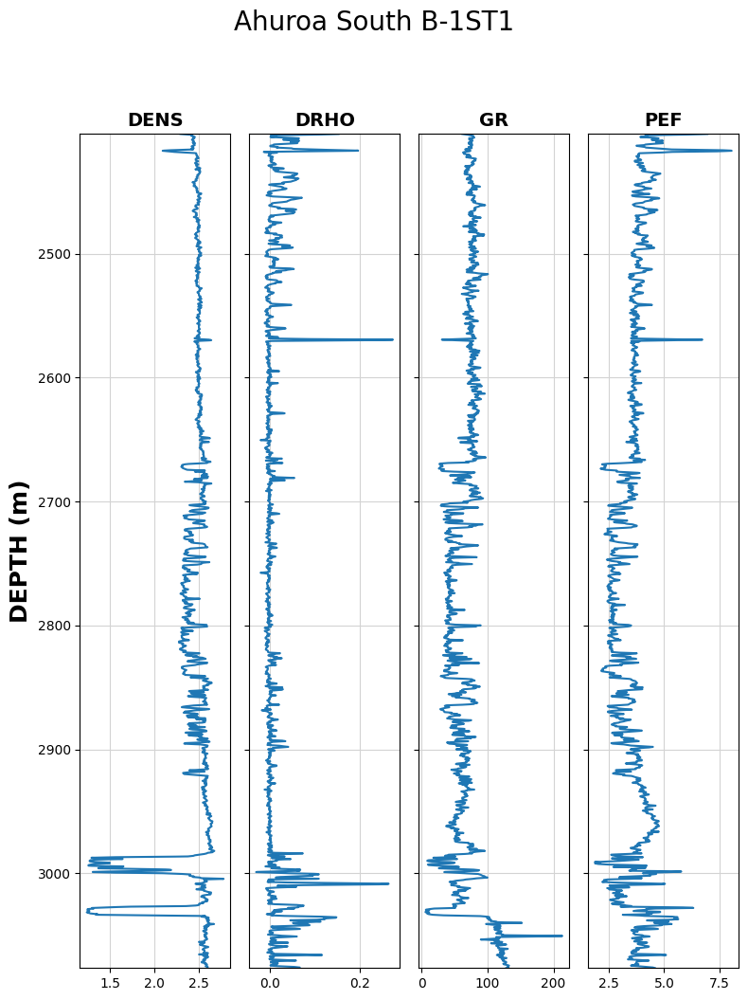

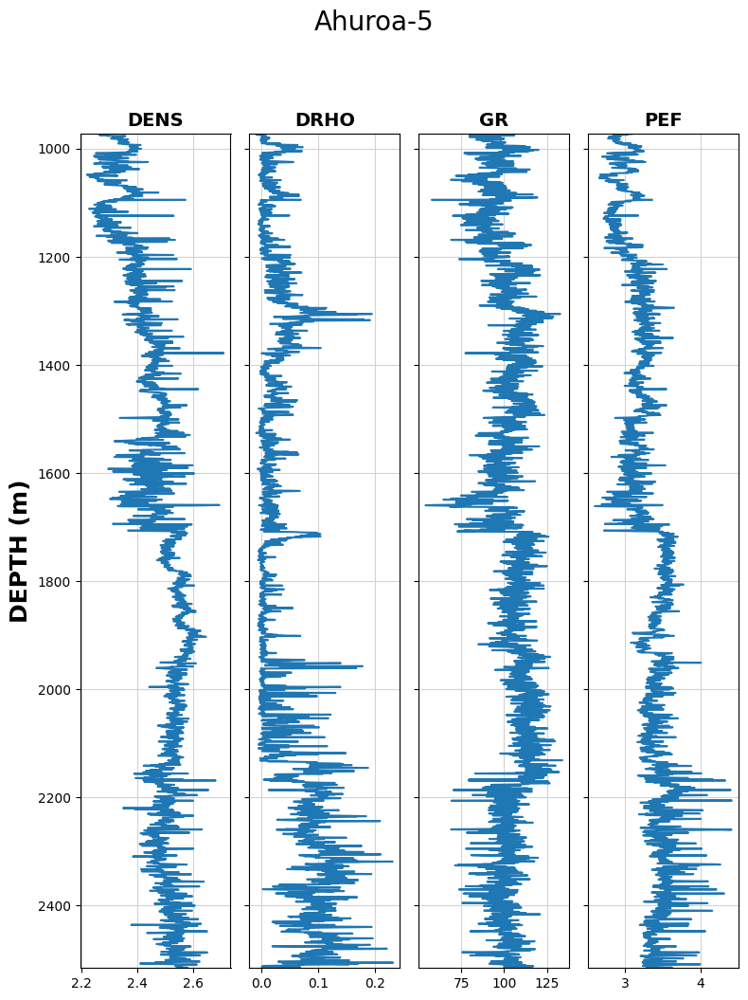

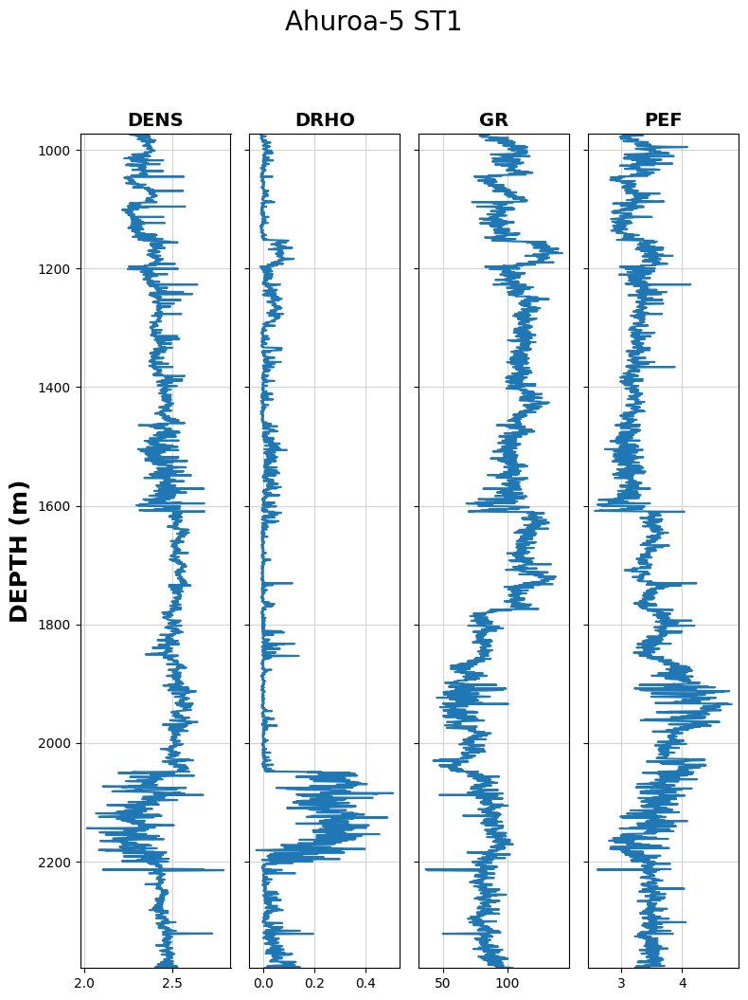

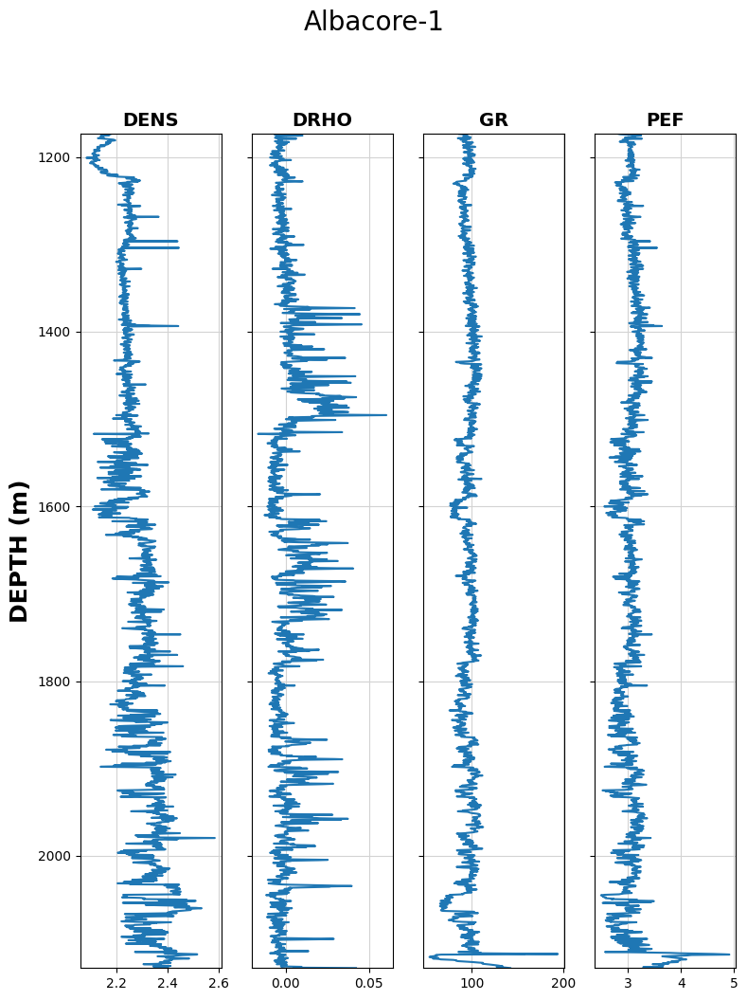

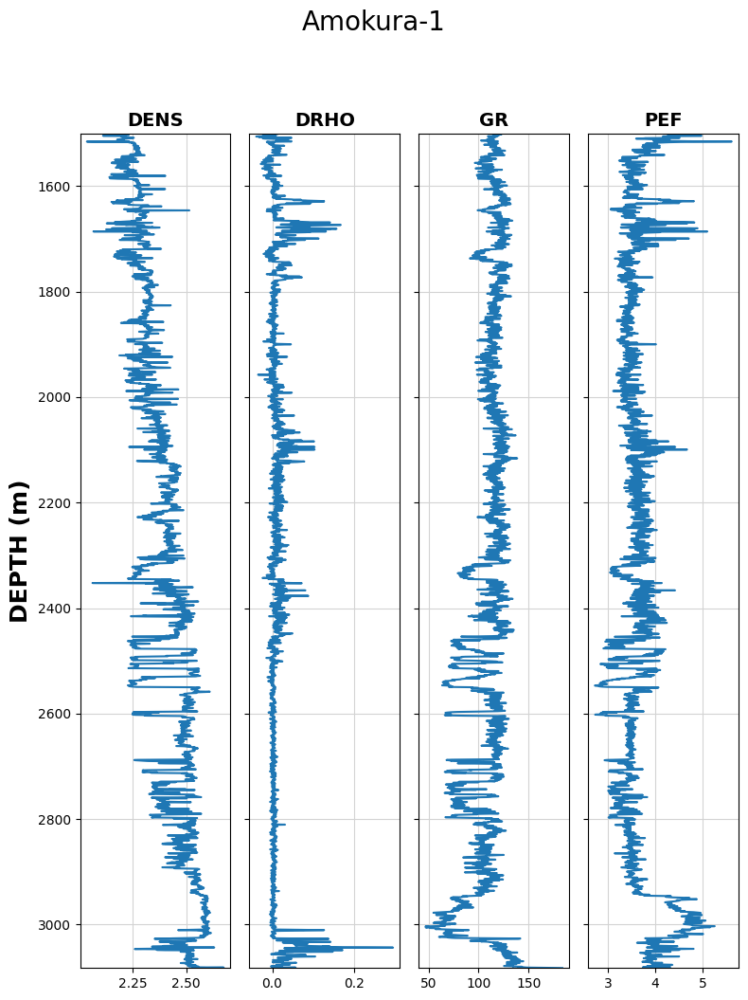

...

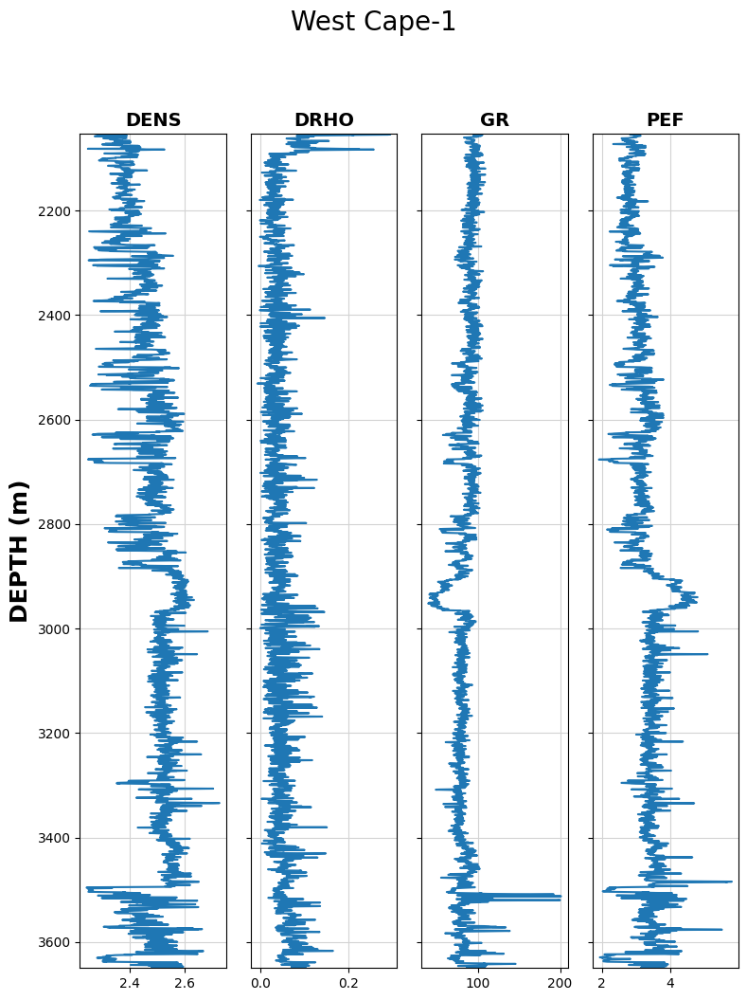

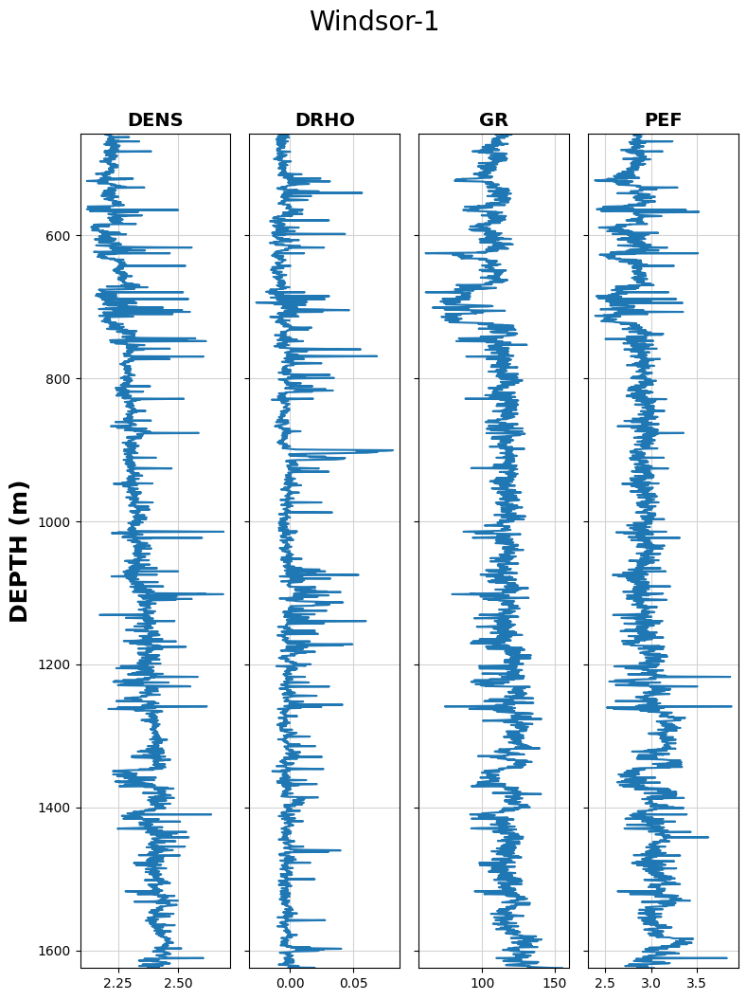

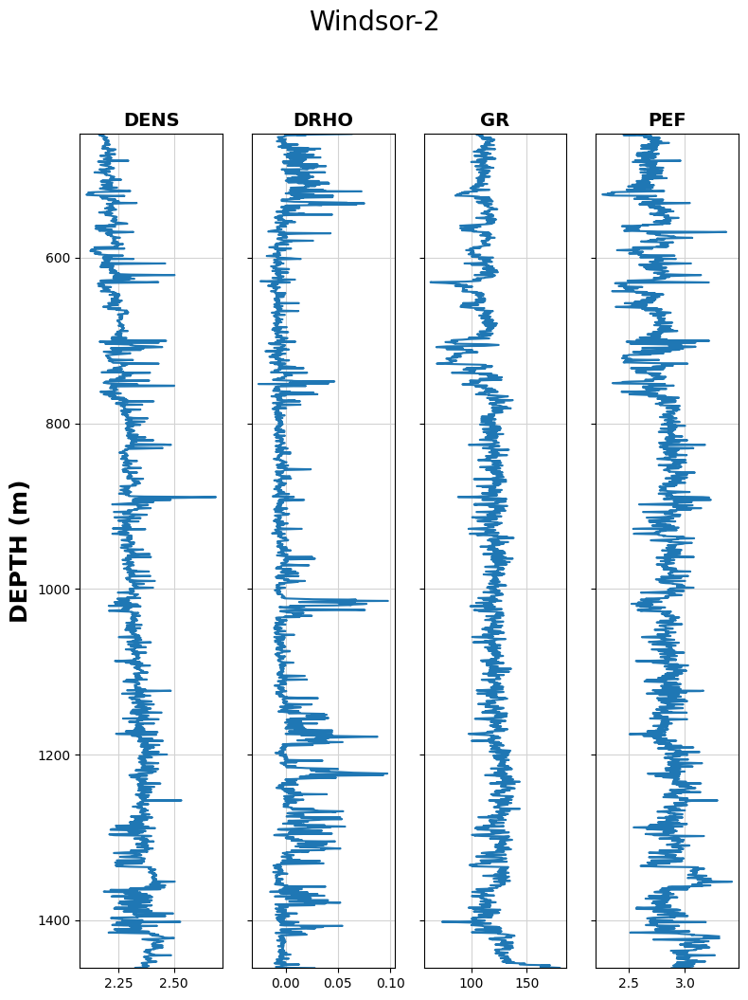

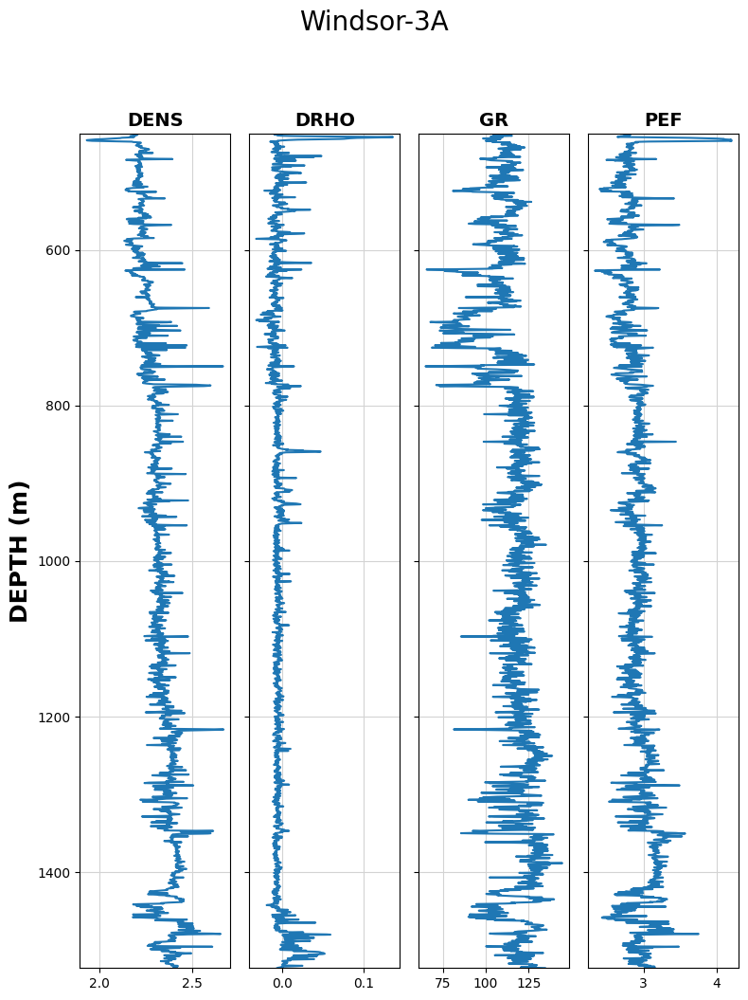

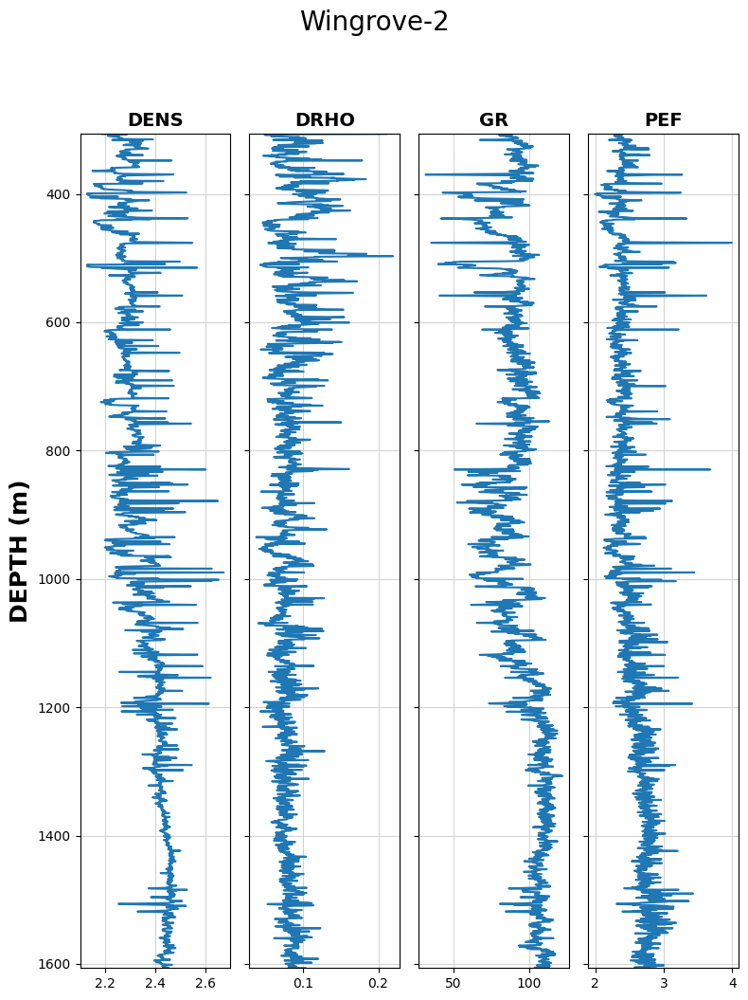

In [ ]:
for well in range(len(wellnames)):
  create_plot(wellnames[well], dfs_wells[well],
              curves_to_plot, dfs_wells[well]['DEPT'])

In [ ]:
df_depth_filtered.to_csv('Taranaki_PEF_clear.csv', index = True)